## Imports

In [3]:
import cv2
import numpy as np
from matplotlib import pyplot as plt
import os
import pandas as pd
from skimage.metrics import peak_signal_noise_ratio as psnr
from skimage.metrics import structural_similarity as ssim
from skimage.measure import shannon_entropy
import csv
import random
random.seed(4206967506)




## Gets Folders and proper prefixes for everything

In [4]:
original_folder_path = '/Users/zevfine/Desktop/Noise_Reduction_CS506/Photos_Subset/Original'
BW = "/Users/zevfine/Desktop/Noise_Reduction_CS506/Photos_Subset/Noised_Images/B&W"
Color = "/Users/zevfine/Desktop/Noise_Reduction_CS506/Photos_Subset/Noised_Images/Color"

#BW
BW_0_20 = "/Users/zevfine/Desktop/Noise_Reduction_CS506/Photos_Subset/Noised_Images/BW/mu_equals_zero/25"
BW_0_50 = "/Users/zevfine/Desktop/Noise_Reduction_CS506/Photos_Subset/Noised_Images/BW/mu_equals_zero/50"
BW_0_100 = "/Users/zevfine/Desktop/Noise_Reduction_CS506/Photos_Subset/Noised_Images/BW/mu_equals_zero/100"
BW_0_150 = "/Users/zevfine/Desktop/Noise_Reduction_CS506/Photos_Subset/Noised_Images/BW/mu_equals_zero/150"
BW_neg_20 = "/Users/zevfine/Desktop/Noise_Reduction_CS506/Photos_Subset/Noised_Images/BW/mu_equals_neg/25"
BW_neg_50 = "/Users/zevfine/Desktop/Noise_Reduction_CS506/Photos_Subset/Noised_Images/BW/mu_equals_neg/50"
BW_neg_100 = "/Users/zevfine/Desktop/Noise_Reduction_CS506/Photos_Subset/Noised_Images/BW/mu_equals_neg/100"
BW_neg_150 = "/Users/zevfine/Desktop/Noise_Reduction_CS506/Photos_Subset/Noised_Images/BW/mu_equals_neg/150"
BW_plus_20 = "/Users/zevfine/Desktop/Noise_Reduction_CS506/Photos_Subset/Noised_Images/BW/mu_equals_pos/25"
BW_plus_50 = "/Users/zevfine/Desktop/Noise_Reduction_CS506/Photos_Subset/Noised_Images/BW/mu_equals_pos/50"
BW_plus_100 = "/Users/zevfine/Desktop/Noise_Reduction_CS506/Photos_Subset/Noised_Images/BW/mu_equals_pos/100"
BW_plus_150 = "/Users/zevfine/Desktop/Noise_Reduction_CS506/Photos_Subset/Noised_Images/BW/mu_equals_pos/150"


#Color
Color_0_20 = "/Users/zevfine/Desktop/Noise_Reduction_CS506/Photos_Subset/Noised_Images/Color/mu_equals_zero/25"
Color_0_50 = "/Users/zevfine/Desktop/Noise_Reduction_CS506/Photos_Subset/Noised_Images/Color/mu_equals_zero/50"
Color_0_150 = "/Users/zevfine/Desktop/Noise_Reduction_CS506/Photos_Subset/Noised_Images/Color/mu_equals_zero/100"
Color_0_100 = "/Users/zevfine/Desktop/Noise_Reduction_CS506/Photos_Subset/Noised_Images/Color/mu_equals_zero/150"
Color_neg_20 = "/Users/zevfine/Desktop/Noise_Reduction_CS506/Photos_Subset/Noised_Images/Color/mu_equals_neg/25"
Color_neg_50 = "/Users/zevfine/Desktop/Noise_Reduction_CS506/Photos_Subset/Noised_Images/Color/mu_equals_neg/50"
Color_neg_100 = "/Users/zevfine/Desktop/Noise_Reduction_CS506/Photos_Subset/Noised_Images/Color/mu_equals_neg/100"
Color_neg_150 = "/Users/zevfine/Desktop/Noise_Reduction_CS506/Photos_Subset/Noised_Images/Color/mu_equals_neg/150"
Color_plus_20 = "/Users/zevfine/Desktop/Noise_Reduction_CS506/Photos_Subset/Noised_Images/Color/mu_equals_pos/25"
Color_plus_50 = "/Users/zevfine/Desktop/Noise_Reduction_CS506/Photos_Subset/Noised_Images/Color/mu_equals_pos/50"
Color_plus_100 = "/Users/zevfine/Desktop/Noise_Reduction_CS506/Photos_Subset/Noised_Images/Color/mu_equals_pos/100"
Color_plus_150 = "/Users/zevfine/Desktop/Noise_Reduction_CS506/Photos_Subset/Noised_Images/Color/mu_equals_pos/150"


#Creates a list
BW_folders = [BW_0_20, BW_0_50, BW_0_100, BW_0_150, BW_neg_20, BW_neg_50, BW_neg_100, BW_neg_150, BW_plus_20, BW_plus_50, BW_plus_100, BW_plus_150]
Color_folders = [Color_0_20, Color_0_50, Color_0_100, Color_0_150, Color_neg_20, Color_neg_50, Color_neg_100, Color_neg_150, Color_plus_20,Color_plus_50, Color_plus_100, Color_plus_150]

#Gets the BW and Color pairs of the original #bw is in [-6:-4]
dict_pics = set() # i know its a set not a dictionary, but this is funnier
tuple_list = []
#creates a list of tuples of each image (color, bw, tuple)
files = list(os.listdir(original_folder_path))
files.sort()
for filename in files:
    if filename in dict_pics:
        continue
    if(filename[-6:-4] == "bw"):
        temp = filename[:-7] + filename[-4:]
        noise_temp = "noisy_" + temp
        noise_temp_bw = "noisy_" + filename
        dict_pics.add(filename) 
        dict_pics.add(temp)
        tuple_list.append((temp, filename, noise_temp, noise_temp_bw))
    else:
        temp = filename[:-4] + "_bw" + filename[-4:]
        noise_temp = "noisy_" + filename
        noise_temp_bw = "noisy_" + temp
        dict_pics.add(filename) 
        dict_pics.add(temp)
        tuple_list.append((filename, temp, noise_temp, noise_temp_bw))

print(tuple_list[1])

('BSDS300_11_66039.jpg', 'BSDS300_11_66039_bw.jpg', 'noisy_BSDS300_11_66039.jpg', 'noisy_BSDS300_11_66039_bw.jpg')


## HyperParamet Tuning

Cutoff that all hyper paremter tuning will get

In [5]:
cutoffs = [5, 10, 20, 30, 40, 50, 60, 70, 80, 90, 100, 150, 200]


## Black and White Denoising

## MU = 0

sigma = 25

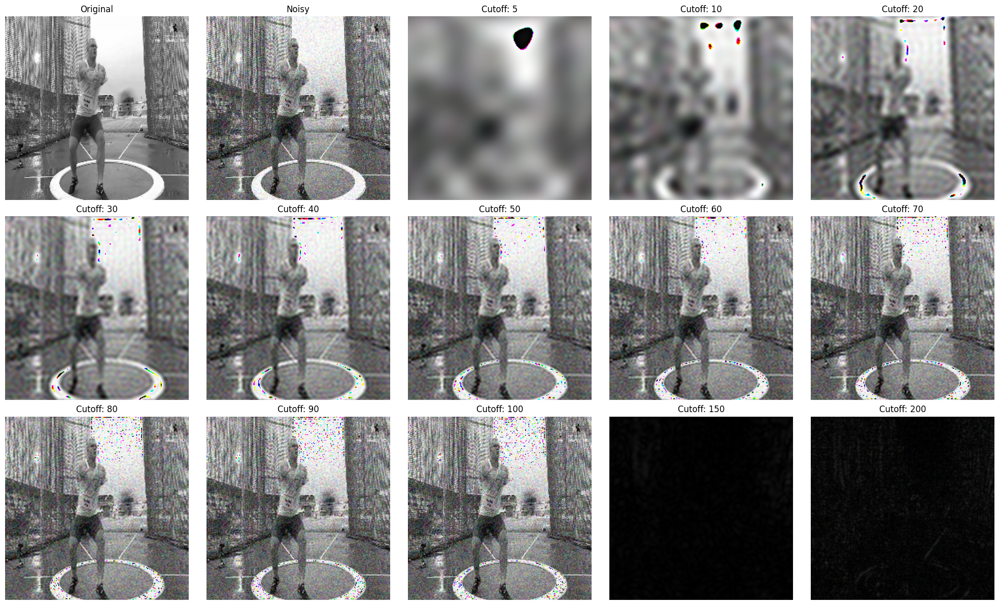

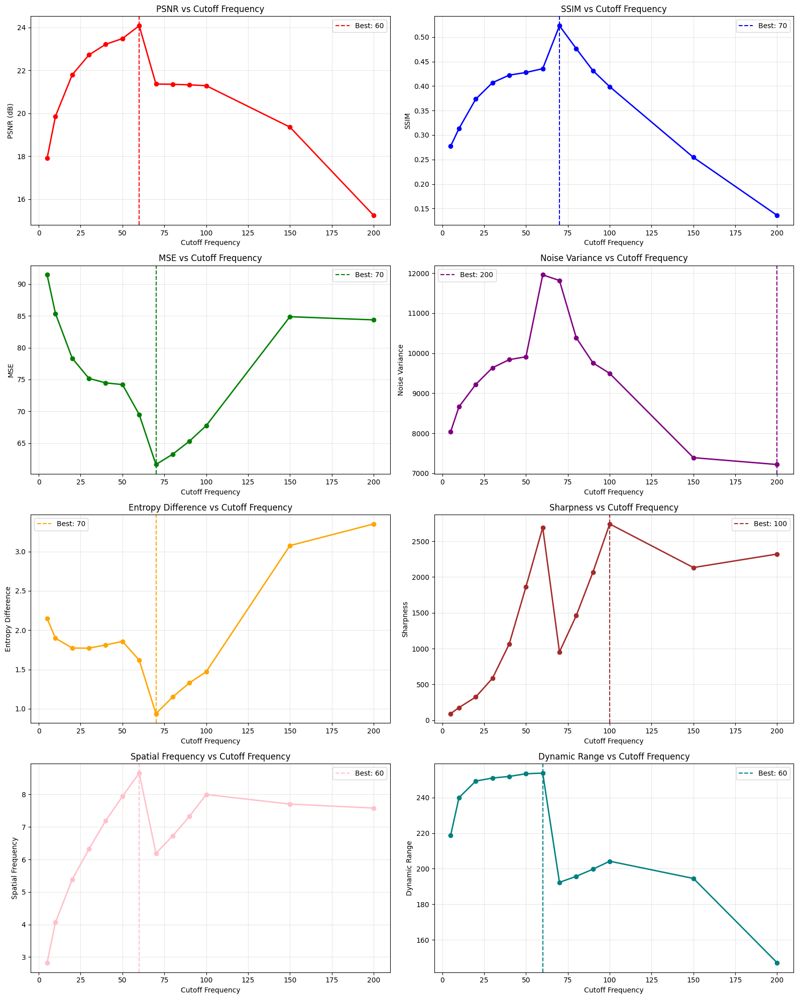

Most frequently best cutoff: 60 (appears 3 times)


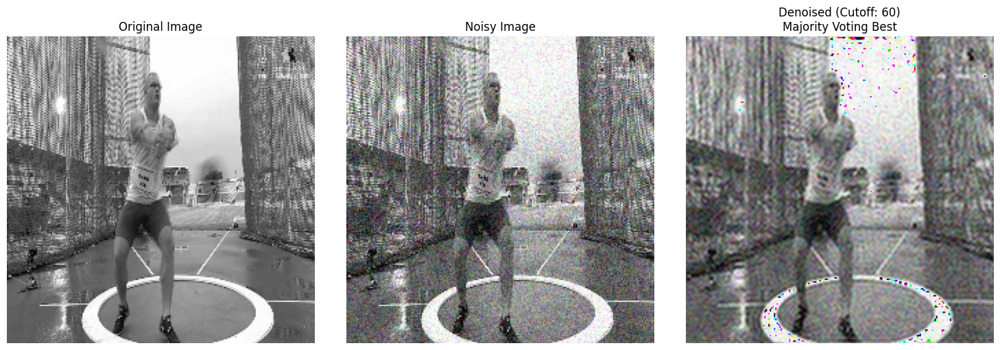

In [6]:
pic = random.randint(0, 79)
# Initialize all metric lists
mast_psnr = []
mast_ssim = []
mast_mse = []
mast_entropy_diff = []
mast_noise_variance = []
mast_sharpness = []
mast_spatial_freq = []
mast_dynamic_range = []
denoised_first_images = []  # Array to store denoised first images

def calculate_sharpness(image):
    # Using Laplacian variance as sharpness measure
    gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    return cv2.Laplacian(gray, cv2.CV_64F).var()

def calculate_spatial_frequency(image):
    gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    rf = np.diff(gray, axis=0)
    cf = np.diff(gray, axis=1)
    return np.sqrt(np.mean(rf**2) + np.mean(cf**2))

def calculate_dynamic_range(image):
    return np.max(image) - np.min(image)

for j in cutoffs: 
    counter = 0
    psnr_list = []
    ssim_list = []
    mse_list = []
    entropy_diff_list = []
    noise_variance_list = []
    sharpness_list = []
    spatial_freq_list = []
    dynamic_range_list = []
    rows_csv = []
    for i in tuple_list:
        original_img_path = original_folder_path + "/" + i[1]
        original_img = cv2.imread(original_img_path)
        original_img = cv2.cvtColor(original_img, cv2.COLOR_BGR2RGB)

        bw_img_path = BW_0_20 + "/" + i[3]
        bw_img = cv2.imread(bw_img_path)
        bw_img = cv2.cvtColor(bw_img, cv2.COLOR_BGR2RGB)

        # Denoising process
        denoised_channels = []
        for channel in range(3):
            channel_data = bw_img[:, :, channel]
            dft = np.fft.fft2(channel_data)
            dft_shift = np.fft.fftshift(dft)

            cutoff = j
            rows, cols = channel_data.shape
            crow, ccol = rows // 2, cols // 2

            mask = np.zeros((rows, cols), np.uint8)
            mask[crow-cutoff:crow+cutoff, ccol-cutoff:ccol+cutoff] = 1

            filtered_shift = dft_shift * mask
            f_ishift = np.fft.ifftshift(filtered_shift)
            denoised_channel = np.fft.ifft2(f_ishift)
            denoised_channel = np.abs(denoised_channel).astype(np.uint8)
            denoised_channels.append(denoised_channel)
        
        denoised = np.stack(denoised_channels, axis=2)
        
        if counter == pic:
            denoised_first_images.append(denoised)

        # Calculate all metrics
        # PSNR
        psnr_value = psnr(original_img, denoised)
        psnr_list.append(psnr_value)
        
        # SSIM
        ssim_value = ssim(original_img, denoised, channel_axis=2, data_range=255)
        ssim_list.append(ssim_value)
        
        # MSE
        mse_value = np.mean((original_img - denoised) ** 2)
        mse_list.append(mse_value)
        
        # Entropy Difference
        orig_entropy = shannon_entropy(original_img)
        denoised_entropy = shannon_entropy(denoised)
        entropy_diff_list.append(abs(orig_entropy - denoised_entropy))
        
        # Noise Variance (estimated as variance of difference)
        noise_variance_list.append(np.var(original_img - denoised))
        
        # Sharpness
        sharpness_list.append(calculate_sharpness(denoised))
        
        # Spatial Frequency
        spatial_freq_list.append(calculate_spatial_frequency(denoised))
        
        # Dynamic Range
        dynamic_range_list.append(calculate_dynamic_range(denoised))

        counter += 1
        rows_csv.append({"Name":i[2], "PSNR": psnr_value, "SSIM": ssim_value, "MSE": mse_value, "Entropy_Diff": abs(orig_entropy - denoised_entropy), 
                 "Noise_Variance": np.var(original_img - denoised), "Sharpness": calculate_sharpness(denoised), "Spatial_Freq": calculate_spatial_frequency(denoised), 
                 "Dynamic_Range": calculate_dynamic_range(denoised), "Majory": False})
    folder = "/Users/zevfine/Desktop/Noise_Reduction_CS506/Data_Results/Data/finished/m_0/25"

    filename = f"Denoised_Cutoff_{cutoff}_N(0,25).csv"
    filepath = os.path.join(folder, filename)

    with open(filepath, mode="w") as csvfile:
        fieldnames = rows_csv[0].keys()
        writer = csv.DictWriter(csvfile, fieldnames=fieldnames)
        writer.writeheader()
        for row_csv in rows_csv:
            writer.writerow(row_csv)   
    # Store average metrics for this cutoff
    mast_psnr.append(np.mean(psnr_list))
    mast_ssim.append(np.mean(ssim_list))
    mast_mse.append(np.mean(mse_list))
    mast_entropy_diff.append(np.mean(entropy_diff_list))
    mast_noise_variance.append(np.mean(noise_variance_list))
    mast_sharpness.append(np.mean(sharpness_list))
    mast_spatial_freq.append(np.mean(spatial_freq_list))
    mast_dynamic_range.append(np.mean(dynamic_range_list))
graphs_folder = "/Users/zevfine/Desktop/Noise_Reduction_CS506/Data_Results/Data/finished/m_0/25/Graph_data"

# Get images for display
original_img_path = original_folder_path + "/" + tuple_list[pic][1]
original_img = cv2.imread(original_img_path)
original_img = cv2.cvtColor(original_img, cv2.COLOR_BGR2RGB)

noisy_img_path = BW_0_20 + "/" + tuple_list[pic][3]
noisy_img = cv2.imread(noisy_img_path)
noisy_img = cv2.cvtColor(noisy_img, cv2.COLOR_BGR2RGB)

all_images = [original_img, noisy_img] + denoised_first_images
all_titles = ["Original", "Noisy"] + [f"Cutoff: {cutoff}" for cutoff in cutoffs]

# Display images
# Display images
if all_images:
    plt.figure(figsize=(20, 12))
    for idx, img in enumerate(all_images):
        plt.subplot(3, 5, idx + 1)
        plt.title(all_titles[idx])
        plt.imshow(img)
        plt.axis('off')
    plt.tight_layout()

    # SAVE BEFORE SHOW
    outpath = os.path.join(graphs_folder, "comparison_grid.png")
    plt.savefig(outpath, dpi=300, bbox_inches='tight')

    # THEN SHOW
    plt.show()



# Find best cutoff for each metric
best_psnr_index = max(range(len(mast_psnr)), key=mast_psnr.__getitem__)
best_psnr_cutoff = cutoffs[best_psnr_index]

best_ssim_index = max(range(len(mast_ssim)), key=mast_ssim.__getitem__)
best_ssim_cutoff = cutoffs[best_ssim_index]

best_mse_index = min(range(len(mast_mse)), key=mast_mse.__getitem__)
best_mse_cutoff = cutoffs[best_mse_index]

best_noise_var_index = min(range(len(mast_noise_variance)), key=mast_noise_variance.__getitem__)
best_noise_var_cutoff = cutoffs[best_noise_var_index]

best_entropy_index = min(range(len(mast_entropy_diff)), key=mast_entropy_diff.__getitem__)
best_entropy_cutoff = cutoffs[best_entropy_index]

best_sharpness_index = max(range(len(mast_sharpness)), key=mast_sharpness.__getitem__)
best_sharpness_cutoff = cutoffs[best_sharpness_index]

best_spatial_freq_index = max(range(len(mast_spatial_freq)), key=mast_spatial_freq.__getitem__)
best_spatial_freq_cutoff = cutoffs[best_spatial_freq_index]

best_dynamic_range_index = max(range(len(mast_dynamic_range)), key=mast_dynamic_range.__getitem__)
best_dynamic_range_cutoff = cutoffs[best_dynamic_range_index]


# Create individual plots for each metric
fig, axes = plt.subplots(4, 2, figsize=(16, 20))
axes = axes.ravel()

# PSNR
axes[0].axvline(x=best_psnr_cutoff, color='red', linestyle='--', label=f'Best: {best_psnr_cutoff}')
axes[0].plot(cutoffs, mast_psnr, color='red', linestyle='-', marker='o', linewidth=2)
axes[0].grid(True, alpha=0.3)
axes[0].set_xlabel('Cutoff Frequency')
axes[0].set_ylabel('PSNR (dB)')
axes[0].set_title('PSNR vs Cutoff Frequency')
axes[0].legend()
extent = axes[0].get_window_extent().transformed(fig.dpi_scale_trans.inverted())
extent = extent.expanded(1.1, 1.25)   # <— increase height to include title
fig.savefig(os.path.join(graphs_folder, "PSNR.png"), dpi=300, bbox_inches=extent)


# SSIM
axes[1].axvline(x=best_ssim_cutoff, color='blue', linestyle='--', label=f'Best: {best_ssim_cutoff}')
axes[1].plot(cutoffs, mast_ssim, color='blue', linestyle='-', marker='o', linewidth=2)
axes[1].grid(True, alpha=0.3)
axes[1].set_xlabel('Cutoff Frequency')
axes[1].set_ylabel('SSIM')
axes[1].set_title('SSIM vs Cutoff Frequency')
axes[1].legend()
extent = axes[1].get_window_extent().transformed(fig.dpi_scale_trans.inverted())
extent = extent.expanded(1.1, 1.25)   # <— increase height to include title
fig.savefig(os.path.join(graphs_folder, "SSIM.png"), dpi=300, bbox_inches=extent)
# MSE
axes[2].axvline(x=best_mse_cutoff, color='green', linestyle='--', label=f'Best: {best_mse_cutoff}')
axes[2].plot(cutoffs, mast_mse, color='green', linestyle='-', marker='o', linewidth=2)
axes[2].grid(True, alpha=0.3)
axes[2].set_xlabel('Cutoff Frequency')
axes[2].set_ylabel('MSE')
axes[2].set_title('MSE vs Cutoff Frequency')
axes[2].legend()
extent = axes[2].get_window_extent().transformed(fig.dpi_scale_trans.inverted())
extent = extent.expanded(1.1, 1.25)   # <— increase height to include title
fig.savefig(os.path.join(graphs_folder, "MSE.png"), dpi=300, bbox_inches=extent)
# Noise Variance
axes[3].axvline(x=best_noise_var_cutoff, color='purple', linestyle='--', label=f'Best: {best_noise_var_cutoff}')
axes[3].plot(cutoffs, mast_noise_variance, color='purple', linestyle='-', marker='o', linewidth=2)
axes[3].grid(True, alpha=0.3)
axes[3].set_xlabel('Cutoff Frequency')
axes[3].set_ylabel('Noise Variance')
axes[3].set_title('Noise Variance vs Cutoff Frequency')
axes[3].legend()
extent = axes[3].get_window_extent().transformed(fig.dpi_scale_trans.inverted())
extent = extent.expanded(1.1, 1.25)   # <— increase height to include title
fig.savefig(os.path.join(graphs_folder, "Noise Variance.png"), dpi=300, bbox_inches=extent)
# Entropy Difference
axes[4].axvline(x=best_entropy_cutoff, color='orange', linestyle='--', label=f'Best: {best_entropy_cutoff}')
axes[4].plot(cutoffs, mast_entropy_diff, color='orange', linestyle='-', marker='o', linewidth=2)
axes[4].grid(True, alpha=0.3)
axes[4].set_xlabel('Cutoff Frequency')
axes[4].set_ylabel('Entropy Difference')
axes[4].set_title('Entropy Difference vs Cutoff Frequency')
axes[4].legend()
extent = axes[4].get_window_extent().transformed(fig.dpi_scale_trans.inverted())
extent = extent.expanded(1.1, 1.25)   # <— increase height to include title
fig.savefig(os.path.join(graphs_folder, "Entropy Difference.png"), dpi=300, bbox_inches=extent)
# Sharpness
axes[5].axvline(x=best_sharpness_cutoff, color='brown', linestyle='--', label=f'Best: {best_sharpness_cutoff}')
axes[5].plot(cutoffs, mast_sharpness, color='brown', linestyle='-', marker='o', linewidth=2)
axes[5].grid(True, alpha=0.3)
axes[5].set_xlabel('Cutoff Frequency')
axes[5].set_ylabel('Sharpness')
axes[5].set_title('Sharpness vs Cutoff Frequency')
axes[5].legend()
extent = axes[5].get_window_extent().transformed(fig.dpi_scale_trans.inverted())
extent = extent.expanded(1.1, 1.25)   # <— increase height to include title
fig.savefig(os.path.join(graphs_folder, "Sharpness.png"), dpi=300, bbox_inches=extent)
# Spatial Frequency
axes[6].axvline(x=best_spatial_freq_cutoff, color='pink', linestyle='--', label=f'Best: {best_spatial_freq_cutoff}')
axes[6].plot(cutoffs, mast_spatial_freq, color='pink', linestyle='-', marker='o', linewidth=2)
axes[6].grid(True, alpha=0.3)
axes[6].set_xlabel('Cutoff Frequency')
axes[6].set_ylabel('Spatial Frequency')
axes[6].set_title('Spatial Frequency vs Cutoff Frequency')
axes[6].legend()
extent = axes[6].get_window_extent().transformed(fig.dpi_scale_trans.inverted())
extent = extent.expanded(1.1, 1.25)   # <— increase height to include title
fig.savefig(os.path.join(graphs_folder, "Spatial Frequency.png"), dpi=300, bbox_inches=extent)
# Dynamic Range
axes[7].axvline(x=best_dynamic_range_cutoff, color='teal', linestyle='--', label=f'Best: {best_dynamic_range_cutoff}')
axes[7].plot(cutoffs, mast_dynamic_range, color='teal', linestyle='-', marker='o', linewidth=2)
axes[7].grid(True, alpha=0.3)
axes[7].set_xlabel('Cutoff Frequency')
axes[7].set_ylabel('Dynamic Range')
axes[7].set_title('Dynamic Range vs Cutoff Frequency')
axes[7].legend()
extent = axes[7].get_window_extent().transformed(fig.dpi_scale_trans.inverted())
extent = extent.expanded(1.1, 1.25)   # <— increase height to include title
fig.savefig(os.path.join(graphs_folder, "Dynamic Range.png"), dpi=300, bbox_inches=extent)


plt.tight_layout()
outpath = os.path.join(graphs_folder, "all_metrics_individual.png")
plt.savefig(outpath, dpi=300, bbox_inches='tight')

plt.show()

# Find majority voting cutoff
best_cutoffs = [best_psnr_cutoff, best_ssim_cutoff, best_mse_cutoff,
                best_sharpness_cutoff, best_spatial_freq_cutoff,
                best_noise_var_cutoff, best_entropy_cutoff, best_dynamic_range_cutoff]

from collections import Counter
cutoff_counts = Counter(best_cutoffs)
most_common_cutoff = cutoff_counts.most_common(1)[0][0]
print(f"Most frequently best cutoff: {most_common_cutoff} (appears {cutoff_counts[most_common_cutoff]} times)")

# Get the denoised image using the majority cutoff
majority_denoised_index = cutoffs.index(most_common_cutoff)
majority_denoised_img = denoised_first_images[majority_denoised_index]

# Get the original and noisy images (image 75)
original_img_path = original_folder_path + "/" + tuple_list[pic][1]
original_img = cv2.imread(original_img_path)
original_img = cv2.cvtColor(original_img, cv2.COLOR_BGR2RGB)

noisy_img_path = BW_0_20 + "/" + tuple_list[pic][3]
noisy_img = cv2.imread(noisy_img_path)
noisy_img = cv2.cvtColor(noisy_img, cv2.COLOR_BGR2RGB)

# Create comparison plot
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Original
axes[0].imshow(original_img)
axes[0].set_title('Original Image')
axes[0].axis('off')

# Noisy
axes[1].imshow(noisy_img)
axes[1].set_title('Noisy Image')
axes[1].axis('off')

# Majority Denoised
axes[2].imshow(majority_denoised_img)
axes[2].set_title(f'Denoised (Cutoff: {most_common_cutoff})\nMajority Voting Best')
axes[2].axis('off')

plt.tight_layout()
outpath = os.path.join(graphs_folder, "Best_comparison_grid.png")
plt.savefig(outpath, dpi=300, bbox_inches='tight')
plt.show()




folder = "/Users/zevfine/Desktop/Noise_Reduction_CS506/Data_Results/Data/finished/m_0/25"

# Load all files
csv_files = sorted([f for f in os.listdir(folder) if f.endswith(".csv")])
# Extract cutoffs from filenames like: Denoised_Cutoff_70.csv
cutoffs = [int(f.split("_")[2].split(".")[0]) for f in csv_files]

# Load as list of DataFrames
dfs = [pd.read_csv(os.path.join(folder, f)) for f in csv_files]

# Assume all CSVs have same number of rows
num_rows = dfs[0].shape[0]

# For each row...
for row in range(num_rows):

    # Collect metric vectors for this row across all cutoffs
    mast_psnr =            [dfs[k].loc[row, "PSNR"]            for k in range(len(dfs))]
    mast_ssim =            [dfs[k].loc[row, "SSIM"]            for k in range(len(dfs))]
    mast_mse =             [dfs[k].loc[row, "MSE"]             for k in range(len(dfs))]
    mast_entropy_diff =    [dfs[k].loc[row, "Entropy_Diff"]    for k in range(len(dfs))]
    mast_noise_variance =  [dfs[k].loc[row, "Noise_Variance"]  for k in range(len(dfs))]
    mast_sharpness =       [dfs[k].loc[row, "Sharpness"]       for k in range(len(dfs))]
    mast_spatial_freq =    [dfs[k].loc[row, "Spatial_Freq"]    for k in range(len(dfs))]
    mast_dynamic_range =   [dfs[k].loc[row, "Dynamic_Range"]   for k in range(len(dfs))]

    # Best cutoffs for each metric
    best_psnr_cutoff          = cutoffs[max(range(len(mast_psnr)),         key=mast_psnr.__getitem__)]
    best_ssim_cutoff          = cutoffs[max(range(len(mast_ssim)),         key=mast_ssim.__getitem__)]
    best_sharpness_cutoff     = cutoffs[max(range(len(mast_sharpness)),    key=mast_sharpness.__getitem__)]
    best_spatial_freq_cutoff  = cutoffs[max(range(len(mast_spatial_freq)), key=mast_spatial_freq.__getitem__)]
    best_dynamic_cutoff       = cutoffs[max(range(len(mast_dynamic_range)),key=mast_dynamic_range.__getitem__)]

    best_mse_cutoff           = cutoffs[min(range(len(mast_mse)),          key=mast_mse.__getitem__)]
    best_entropy_cutoff       = cutoffs[min(range(len(mast_entropy_diff)), key=mast_entropy_diff.__getitem__)]
    best_noise_cutoff         = cutoffs[min(range(len(mast_noise_variance)),key=mast_noise_variance.__getitem__)]

    # Count votes
    votes = [
        best_psnr_cutoff, best_ssim_cutoff, best_sharpness_cutoff,
        best_spatial_freq_cutoff, best_dynamic_cutoff,
        best_mse_cutoff, best_entropy_cutoff, best_noise_cutoff
    ]

    # Find majority cutoff
    majority_cutoff = pd.Series(votes).mode().iloc[0]
    # Update Majory column for that cutoff’s CSV
    winning_index = cutoffs.index(majority_cutoff)
    dfs[winning_index].loc[row, "Majory"] = True

# Save all CSV files back
for k, f in enumerate(csv_files):
    dfs[k].to_csv(os.path.join(folder, f), index=False)

50

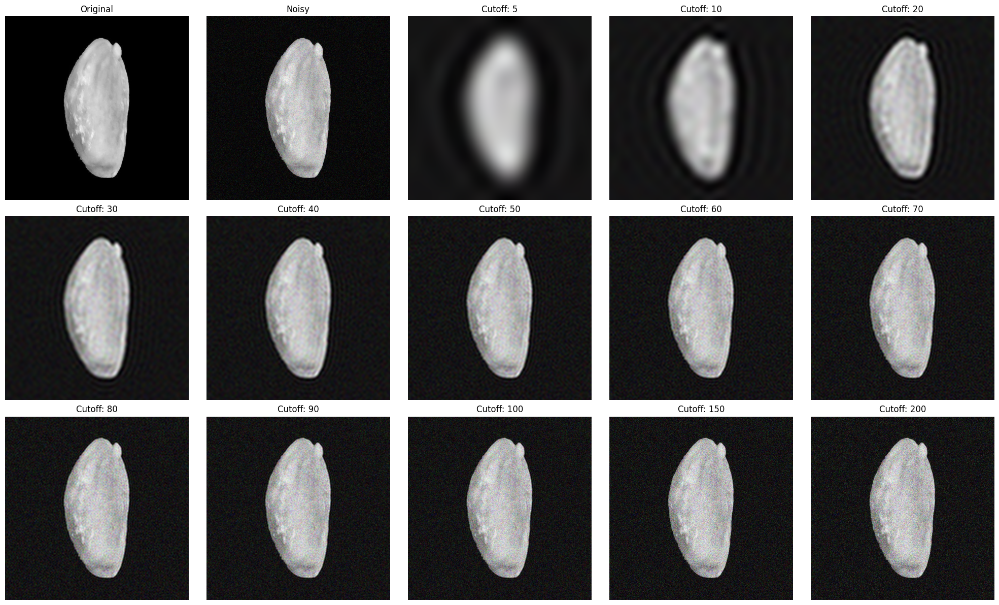

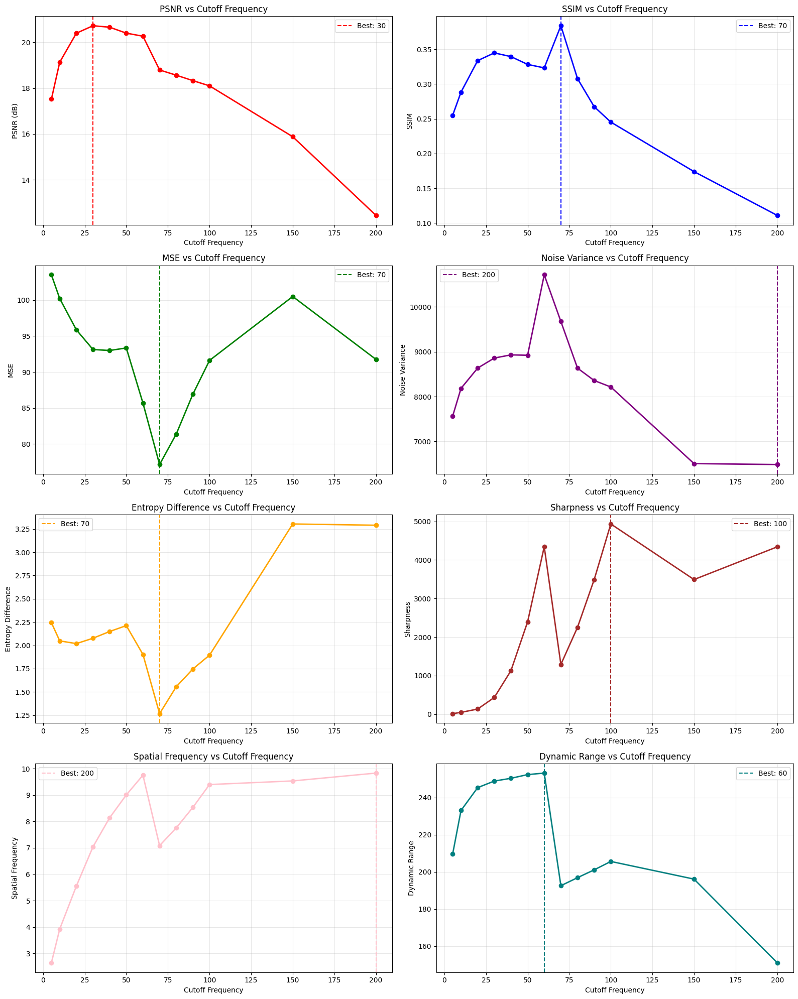

Most frequently best cutoff: 70 (appears 3 times)


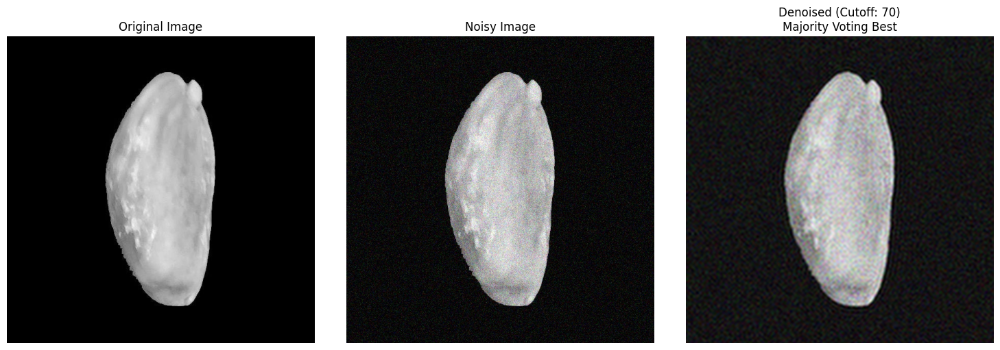

['Denoised_Cutoff_5_N(0,25).csv', 'Denoised_Cutoff_10_N(0,25).csv', 'Denoised_Cutoff_20_N(0,25).csv', 'Denoised_Cutoff_30_N(0,25).csv', 'Denoised_Cutoff_40_N(0,25).csv', 'Denoised_Cutoff_50_N(0,25).csv', 'Denoised_Cutoff_60_N(0,25).csv', 'Denoised_Cutoff_70_N(0,25).csv', 'Denoised_Cutoff_80_N(0,25).csv', 'Denoised_Cutoff_90_N(0,25).csv', 'Denoised_Cutoff_100_N(0,25).csv', 'Denoised_Cutoff_150_N(0,25).csv', 'Denoised_Cutoff_200_N(0,25).csv']
DEBUG: CSV cutoffs after extraction: [5, 10, 20, 30, 40, 50, 60, 70, 80, 90, 100, 150, 200]
DEBUG: CSV files order: ['Denoised_Cutoff_5_N(0,25).csv', 'Denoised_Cutoff_10_N(0,25).csv', 'Denoised_Cutoff_20_N(0,25).csv', 'Denoised_Cutoff_30_N(0,25).csv', 'Denoised_Cutoff_40_N(0,25).csv', 'Denoised_Cutoff_50_N(0,25).csv', 'Denoised_Cutoff_60_N(0,25).csv', 'Denoised_Cutoff_70_N(0,25).csv', 'Denoised_Cutoff_80_N(0,25).csv', 'Denoised_Cutoff_90_N(0,25).csv', 'Denoised_Cutoff_100_N(0,25).csv', 'Denoised_Cutoff_150_N(0,25).csv', 'Denoised_Cutoff_200_N(0,25).

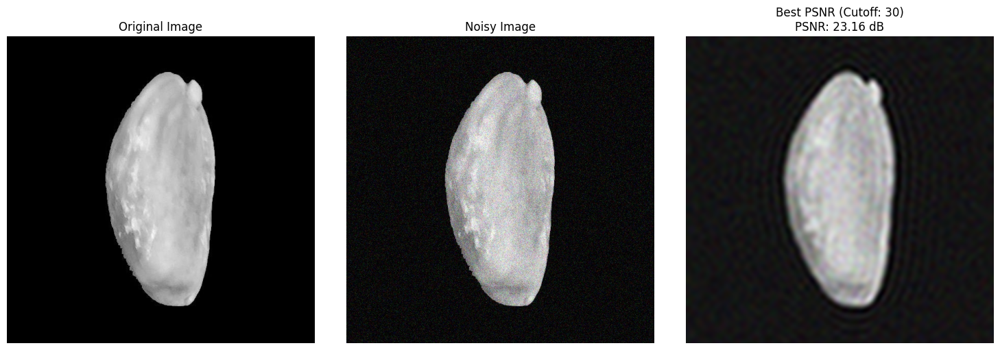

In [9]:
pic = random.randint(0, 79)
plt.close('all')
# Initialize all metric lists
mast_psnr = []
mast_ssim = []
mast_mse = []
mast_entropy_diff = []
mast_noise_variance = []
mast_sharpness = []
mast_spatial_freq = []
mast_dynamic_range = []
denoised_first_images = []  # Array to store denoised first images

def calculate_sharpness(image):
    # Using Laplacian variance as sharpness measure
    gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    return cv2.Laplacian(gray, cv2.CV_64F).var()

def calculate_spatial_frequency(image):
    gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    rf = np.diff(gray, axis=0)
    cf = np.diff(gray, axis=1)
    return np.sqrt(np.mean(rf**2) + np.mean(cf**2))

def calculate_dynamic_range(image):
    return np.max(image) - np.min(image)

for j in cutoffs: 
    counter = 0
    psnr_list = []
    ssim_list = []
    mse_list = []
    entropy_diff_list = []
    noise_variance_list = []
    sharpness_list = []
    spatial_freq_list = []
    dynamic_range_list = []
    rows_csv = []
    for i in tuple_list:
        original_img_path = original_folder_path + "/" + i[1]
        original_img = cv2.imread(original_img_path)
        original_img = cv2.cvtColor(original_img, cv2.COLOR_BGR2RGB)

        bw_img_path = BW_0_50 + "/" + i[3]
        bw_img = cv2.imread(bw_img_path)
        bw_img = cv2.cvtColor(bw_img, cv2.COLOR_BGR2RGB)

        # Denoising process
        denoised_channels = []
        for channel in range(3):
            channel_data = bw_img[:, :, channel]
            dft = np.fft.fft2(channel_data)
            dft_shift = np.fft.fftshift(dft)

            cutoff = j
            rows, cols = channel_data.shape
            crow, ccol = rows // 2, cols // 2

            mask = np.zeros((rows, cols), np.uint8)
            mask[crow-cutoff:crow+cutoff, ccol-cutoff:ccol+cutoff] = 1

            filtered_shift = dft_shift * mask
            f_ishift = np.fft.ifftshift(filtered_shift)
            denoised_channel = np.fft.ifft2(f_ishift)
            denoised_channel = np.abs(denoised_channel).astype(np.uint8)
            denoised_channels.append(denoised_channel)
        
        denoised = np.stack(denoised_channels, axis=2)
        
        if counter == pic:
            denoised_first_images.append(denoised)

        # Calculate all metrics
        # PSNR
        psnr_value = psnr(original_img, denoised)
        psnr_list.append(psnr_value)
        
        # SSIM
        ssim_value = ssim(original_img, denoised, channel_axis=2, data_range=255)
        ssim_list.append(ssim_value)
        
        # MSE
        mse_value = np.mean((original_img - denoised) ** 2)
        mse_list.append(mse_value)
        
        # Entropy Difference
        orig_entropy = shannon_entropy(original_img)
        denoised_entropy = shannon_entropy(denoised)
        entropy_diff_list.append(abs(orig_entropy - denoised_entropy))
        
        # Noise Variance (estimated as variance of difference)
        noise_variance_list.append(np.var(original_img - denoised))
        
        # Sharpness
        sharpness_list.append(calculate_sharpness(denoised))
        
        # Spatial Frequency
        spatial_freq_list.append(calculate_spatial_frequency(denoised))
        
        # Dynamic Range
        dynamic_range_list.append(calculate_dynamic_range(denoised))

        counter += 1
        rows_csv.append({"Name":i[2], "PSNR": psnr_value, "SSIM": ssim_value, "MSE": mse_value, "Entropy_Diff": abs(orig_entropy - denoised_entropy), 
                 "Noise_Variance": np.var(original_img - denoised), "Sharpness": calculate_sharpness(denoised), "Spatial_Freq": calculate_spatial_frequency(denoised), 
                 "Dynamic_Range": calculate_dynamic_range(denoised), "Majory": False})
    folder = "/Users/zevfine/Desktop/Noise_Reduction_CS506/Data_Results/Data/finished/m_0/50"

    filename = f"Denoised_Cutoff_{j}_N(0,25).csv"
    filepath = os.path.join(folder, filename)

    with open(filepath, mode="w") as csvfile:
        fieldnames = rows_csv[0].keys()
        writer = csv.DictWriter(csvfile, fieldnames=fieldnames)
        writer.writeheader()
        for row_csv in rows_csv:
            writer.writerow(row_csv)   
    # Store average metrics for this cutoff
    mast_psnr.append(np.mean(psnr_list))
    mast_ssim.append(np.mean(ssim_list))
    mast_mse.append(np.mean(mse_list))
    mast_entropy_diff.append(np.mean(entropy_diff_list))
    mast_noise_variance.append(np.mean(noise_variance_list))
    mast_sharpness.append(np.mean(sharpness_list))
    mast_spatial_freq.append(np.mean(spatial_freq_list))
    mast_dynamic_range.append(np.mean(dynamic_range_list))
graphs_folder = "/Users/zevfine/Desktop/Noise_Reduction_CS506/Data_Results/Data/finished/m_0/50/Graph_data"

# Get images for display
original_img_path = original_folder_path + "/" + tuple_list[pic][1]
original_img = cv2.imread(original_img_path)
original_img = cv2.cvtColor(original_img, cv2.COLOR_BGR2RGB)

noisy_img_path = BW_0_20 + "/" + tuple_list[pic][3]
noisy_img = cv2.imread(noisy_img_path)
noisy_img = cv2.cvtColor(noisy_img, cv2.COLOR_BGR2RGB)

all_images = [original_img, noisy_img] + denoised_first_images
all_titles = ["Original", "Noisy"] + [f"Cutoff: {cutoff}" for cutoff in cutoffs]

# Display images
# Display images
if all_images:
    plt.figure(figsize=(20, 12))
    for idx, img in enumerate(all_images):
        plt.subplot(3, 5, idx + 1)
        plt.title(all_titles[idx])
        plt.imshow(img)
        plt.axis('off')
    plt.tight_layout()

    # SAVE BEFORE SHOW
    outpath = os.path.join(graphs_folder, "comparison_grid.png")
    plt.savefig(outpath, dpi=300, bbox_inches='tight')

    # THEN SHOW
    plt.show()



# Find best cutoff for each metric
best_psnr_index = max(range(len(mast_psnr)), key=mast_psnr.__getitem__)
best_psnr_cutoff = cutoffs[best_psnr_index]

best_ssim_index = max(range(len(mast_ssim)), key=mast_ssim.__getitem__)
best_ssim_cutoff = cutoffs[best_ssim_index]

best_mse_index = min(range(len(mast_mse)), key=mast_mse.__getitem__)
best_mse_cutoff = cutoffs[best_mse_index]

best_noise_var_index = min(range(len(mast_noise_variance)), key=mast_noise_variance.__getitem__)
best_noise_var_cutoff = cutoffs[best_noise_var_index]

best_entropy_index = min(range(len(mast_entropy_diff)), key=mast_entropy_diff.__getitem__)
best_entropy_cutoff = cutoffs[best_entropy_index]

best_sharpness_index = max(range(len(mast_sharpness)), key=mast_sharpness.__getitem__)
best_sharpness_cutoff = cutoffs[best_sharpness_index]

best_spatial_freq_index = max(range(len(mast_spatial_freq)), key=mast_spatial_freq.__getitem__)
best_spatial_freq_cutoff = cutoffs[best_spatial_freq_index]

best_dynamic_range_index = max(range(len(mast_dynamic_range)), key=mast_dynamic_range.__getitem__)
best_dynamic_range_cutoff = cutoffs[best_dynamic_range_index]


# Check for duplicates
if len(cutoffs) != len(set(cutoffs)):
    print(f"WARNING: Duplicate cutoff values found!")
    from collections import Counter
    dup_counts = Counter(cutoffs)
    for cutoff, count in dup_counts.items():
        if count > 1:
            print(f"  Cutoff {cutoff} appears {count} times")

# Check if lengths match
if len(cutoffs) != len(mast_psnr):
    print(f"ERROR: Mismatch! cutoffs: {len(cutoffs)}, mast_psnr: {len(mast_psnr)}")

# Create individual plots for each metric
fig, axes = plt.subplots(4, 2, figsize=(16, 20))
axes = axes.ravel()

# PSNR
axes[0].axvline(x=best_psnr_cutoff, color='red', linestyle='--', label=f'Best: {best_psnr_cutoff}')
axes[0].plot(cutoffs, mast_psnr, color='red', linestyle='-', marker='o', linewidth=2)
axes[0].grid(True, alpha=0.3)
axes[0].set_xlabel('Cutoff Frequency')
axes[0].set_ylabel('PSNR (dB)')
axes[0].set_title('PSNR vs Cutoff Frequency')
axes[0].legend()
extent = axes[0].get_window_extent().transformed(fig.dpi_scale_trans.inverted())
extent = extent.expanded(1.1, 1.25)   # <— increase height to include title
fig.savefig(os.path.join(graphs_folder, "PSNR.png"), dpi=300, bbox_inches=extent)


# SSIM
axes[1].axvline(x=best_ssim_cutoff, color='blue', linestyle='--', label=f'Best: {best_ssim_cutoff}')
axes[1].plot(cutoffs, mast_ssim, color='blue', linestyle='-', marker='o', linewidth=2)
axes[1].grid(True, alpha=0.3)
axes[1].set_xlabel('Cutoff Frequency')
axes[1].set_ylabel('SSIM')
axes[1].set_title('SSIM vs Cutoff Frequency')
axes[1].legend()
extent = axes[1].get_window_extent().transformed(fig.dpi_scale_trans.inverted())
extent = extent.expanded(1.1, 1.25)   # <— increase height to include title
fig.savefig(os.path.join(graphs_folder, "SSIM.png"), dpi=300, bbox_inches=extent)
# MSE
axes[2].axvline(x=best_mse_cutoff, color='green', linestyle='--', label=f'Best: {best_mse_cutoff}')
axes[2].plot(cutoffs, mast_mse, color='green', linestyle='-', marker='o', linewidth=2)
axes[2].grid(True, alpha=0.3)
axes[2].set_xlabel('Cutoff Frequency')
axes[2].set_ylabel('MSE')
axes[2].set_title('MSE vs Cutoff Frequency')
axes[2].legend()
extent = axes[2].get_window_extent().transformed(fig.dpi_scale_trans.inverted())
extent = extent.expanded(1.1, 1.25)   # <— increase height to include title
fig.savefig(os.path.join(graphs_folder, "MSE.png"), dpi=300, bbox_inches=extent)
# Noise Variance
axes[3].axvline(x=best_noise_var_cutoff, color='purple', linestyle='--', label=f'Best: {best_noise_var_cutoff}')
axes[3].plot(cutoffs, mast_noise_variance, color='purple', linestyle='-', marker='o', linewidth=2)
axes[3].grid(True, alpha=0.3)
axes[3].set_xlabel('Cutoff Frequency')
axes[3].set_ylabel('Noise Variance')
axes[3].set_title('Noise Variance vs Cutoff Frequency')
axes[3].legend()
extent = axes[3].get_window_extent().transformed(fig.dpi_scale_trans.inverted())
extent = extent.expanded(1.1, 1.25)   # <— increase height to include title
fig.savefig(os.path.join(graphs_folder, "Noise Variance.png"), dpi=300, bbox_inches=extent)
# Entropy Difference
axes[4].axvline(x=best_entropy_cutoff, color='orange', linestyle='--', label=f'Best: {best_entropy_cutoff}')
axes[4].plot(cutoffs, mast_entropy_diff, color='orange', linestyle='-', marker='o', linewidth=2)
axes[4].grid(True, alpha=0.3)
axes[4].set_xlabel('Cutoff Frequency')
axes[4].set_ylabel('Entropy Difference')
axes[4].set_title('Entropy Difference vs Cutoff Frequency')
axes[4].legend()
extent = axes[4].get_window_extent().transformed(fig.dpi_scale_trans.inverted())
extent = extent.expanded(1.1, 1.25)   # <— increase height to include title
fig.savefig(os.path.join(graphs_folder, "Entropy Difference.png"), dpi=300, bbox_inches=extent)
# Sharpness
axes[5].axvline(x=best_sharpness_cutoff, color='brown', linestyle='--', label=f'Best: {best_sharpness_cutoff}')
axes[5].plot(cutoffs, mast_sharpness, color='brown', linestyle='-', marker='o', linewidth=2)
axes[5].grid(True, alpha=0.3)
axes[5].set_xlabel('Cutoff Frequency')
axes[5].set_ylabel('Sharpness')
axes[5].set_title('Sharpness vs Cutoff Frequency')
axes[5].legend()
extent = axes[5].get_window_extent().transformed(fig.dpi_scale_trans.inverted())
extent = extent.expanded(1.1, 1.25)   # <— increase height to include title
fig.savefig(os.path.join(graphs_folder, "Sharpness.png"), dpi=300, bbox_inches=extent)
# Spatial Frequency
axes[6].axvline(x=best_spatial_freq_cutoff, color='pink', linestyle='--', label=f'Best: {best_spatial_freq_cutoff}')
axes[6].plot(cutoffs, mast_spatial_freq, color='pink', linestyle='-', marker='o', linewidth=2)
axes[6].grid(True, alpha=0.3)
axes[6].set_xlabel('Cutoff Frequency')
axes[6].set_ylabel('Spatial Frequency')
axes[6].set_title('Spatial Frequency vs Cutoff Frequency')
axes[6].legend()
extent = axes[6].get_window_extent().transformed(fig.dpi_scale_trans.inverted())
extent = extent.expanded(1.1, 1.25)   # <— increase height to include title
fig.savefig(os.path.join(graphs_folder, "Spatial Frequency.png"), dpi=300, bbox_inches=extent)
# Dynamic Range
axes[7].axvline(x=best_dynamic_range_cutoff, color='teal', linestyle='--', label=f'Best: {best_dynamic_range_cutoff}')
axes[7].plot(cutoffs, mast_dynamic_range, color='teal', linestyle='-', marker='o', linewidth=2)
axes[7].grid(True, alpha=0.3)
axes[7].set_xlabel('Cutoff Frequency')
axes[7].set_ylabel('Dynamic Range')
axes[7].set_title('Dynamic Range vs Cutoff Frequency')
axes[7].legend()
extent = axes[7].get_window_extent().transformed(fig.dpi_scale_trans.inverted())
extent = extent.expanded(1.1, 1.25)   # <— increase height to include title
fig.savefig(os.path.join(graphs_folder, "Dynamic Range.png"), dpi=300, bbox_inches=extent)


plt.tight_layout()
outpath = os.path.join(graphs_folder, "all_metrics_individual.png")
plt.savefig(outpath, dpi=300, bbox_inches='tight')

plt.show()

# Find majority voting cutoff
best_cutoffs = [best_psnr_cutoff, best_ssim_cutoff, best_mse_cutoff,
                best_sharpness_cutoff, best_spatial_freq_cutoff,
                best_noise_var_cutoff, best_entropy_cutoff, best_dynamic_range_cutoff]

from collections import Counter
cutoff_counts = Counter(best_cutoffs)
most_common_cutoff = cutoff_counts.most_common(1)[0][0]
print(f"Most frequently best cutoff: {most_common_cutoff} (appears {cutoff_counts[most_common_cutoff]} times)")

# Get the denoised image using the majority cutoff
majority_denoised_index = cutoffs.index(most_common_cutoff)
majority_denoised_img = denoised_first_images[majority_denoised_index]

# Get the original and noisy images (image 75)
original_img_path = original_folder_path + "/" + tuple_list[pic][1]
original_img = cv2.imread(original_img_path)
original_img = cv2.cvtColor(original_img, cv2.COLOR_BGR2RGB)

noisy_img_path = BW_0_20 + "/" + tuple_list[pic][3]
noisy_img = cv2.imread(noisy_img_path)
noisy_img = cv2.cvtColor(noisy_img, cv2.COLOR_BGR2RGB)

# Create comparison plot
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Original
axes[0].imshow(original_img)
axes[0].set_title('Original Image')
axes[0].axis('off')

# Noisy
axes[1].imshow(noisy_img)
axes[1].set_title('Noisy Image')
axes[1].axis('off')

# Majority Denoised
axes[2].imshow(majority_denoised_img)
axes[2].set_title(f'Denoised (Cutoff: {most_common_cutoff})\nMajority Voting Best')
axes[2].axis('off')

plt.tight_layout()
outpath = os.path.join(graphs_folder, "Best_comparison_grid.png")
plt.savefig(outpath, dpi=300, bbox_inches='tight')
plt.show()




folder = "/Users/zevfine/Desktop/Noise_Reduction_CS506/Data_Results/Data/finished/m_0/50"

# Load all files
csv_files = sorted([f for f in os.listdir(folder) if f.endswith(".csv")], 
                   key=lambda x: int(x.split("_")[2].split(".")[0]))
print(csv_files)
# Extract cutoffs from filenames like: Denoised_Cutoff_70.csv
cutoffs = [int(f.split("_")[2].split(".")[0]) for f in csv_files]


# Extract cutoffs from filenames like: Denoised_Cutoff_70.csv
cutoffs = [int(f.split("_")[2].split(".")[0]) for f in csv_files]
print(f"DEBUG: CSV cutoffs after extraction: {cutoffs}")
print(f"DEBUG: CSV files order: {csv_files}")

# Load as list of DataFrames
dfs = [pd.read_csv(os.path.join(folder, f)) for f in csv_files]

# Assume all CSVs have same number of rows
num_rows = dfs[0].shape[0]

# For each row...
for row in range(num_rows):

    # Collect metric vectors for this row across all cutoffs
    mast_psnr =            [dfs[k].loc[row, "PSNR"]            for k in range(len(dfs))]
    mast_ssim =            [dfs[k].loc[row, "SSIM"]            for k in range(len(dfs))]
    mast_mse =             [dfs[k].loc[row, "MSE"]             for k in range(len(dfs))]
    mast_entropy_diff =    [dfs[k].loc[row, "Entropy_Diff"]    for k in range(len(dfs))]
    mast_noise_variance =  [dfs[k].loc[row, "Noise_Variance"]  for k in range(len(dfs))]
    mast_sharpness =       [dfs[k].loc[row, "Sharpness"]       for k in range(len(dfs))]
    mast_spatial_freq =    [dfs[k].loc[row, "Spatial_Freq"]    for k in range(len(dfs))]
    mast_dynamic_range =   [dfs[k].loc[row, "Dynamic_Range"]   for k in range(len(dfs))]

    # Best cutoffs for each metric
    best_psnr_cutoff          = cutoffs[max(range(len(mast_psnr)),         key=mast_psnr.__getitem__)]
    best_ssim_cutoff          = cutoffs[max(range(len(mast_ssim)),         key=mast_ssim.__getitem__)]
    best_sharpness_cutoff     = cutoffs[max(range(len(mast_sharpness)),    key=mast_sharpness.__getitem__)]
    best_spatial_freq_cutoff  = cutoffs[max(range(len(mast_spatial_freq)), key=mast_spatial_freq.__getitem__)]
    best_dynamic_cutoff       = cutoffs[max(range(len(mast_dynamic_range)),key=mast_dynamic_range.__getitem__)]

    best_mse_cutoff           = cutoffs[min(range(len(mast_mse)),          key=mast_mse.__getitem__)]
    best_entropy_cutoff       = cutoffs[min(range(len(mast_entropy_diff)), key=mast_entropy_diff.__getitem__)]
    best_noise_cutoff         = cutoffs[min(range(len(mast_noise_variance)),key=mast_noise_variance.__getitem__)]

    # Count votes
    votes = [
        best_psnr_cutoff, best_ssim_cutoff, best_sharpness_cutoff,
        best_spatial_freq_cutoff, best_dynamic_cutoff,
        best_mse_cutoff, best_entropy_cutoff, best_noise_cutoff
    ]

    # Find majority cutoff
    majority_cutoff = pd.Series(votes).mode().iloc[0]
    # Update Majory column for that cutoff’s CSV
    winning_index = cutoffs.index(majority_cutoff)
    dfs[winning_index].loc[row, "Majory"] = True

# Create comparison plot with Best PSNR instead of Majority
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Original
axes[0].imshow(original_img)
axes[0].set_title('Original Image')
axes[0].axis('off')

# Noisy
axes[1].imshow(noisy_img)
axes[1].set_title('Noisy Image')
axes[1].axis('off')

# Best PSNR
best_psnr_img = denoised_first_images[best_psnr_index]
axes[2].imshow(best_psnr_img)
axes[2].set_title(f'Best PSNR (Cutoff: {best_psnr_cutoff})\nPSNR: {mast_psnr[best_psnr_index]:.2f} dB')
axes[2].axis('off')

plt.tight_layout()
outpath = os.path.join(graphs_folder, "Best_PSNR_comparison.png")
plt.savefig(outpath, dpi=300, bbox_inches='tight')
plt.show()

# Save all CSV files back
for k, f in enumerate(csv_files):
    dfs[k].to_csv(os.path.join(folder, f), index=False)

100

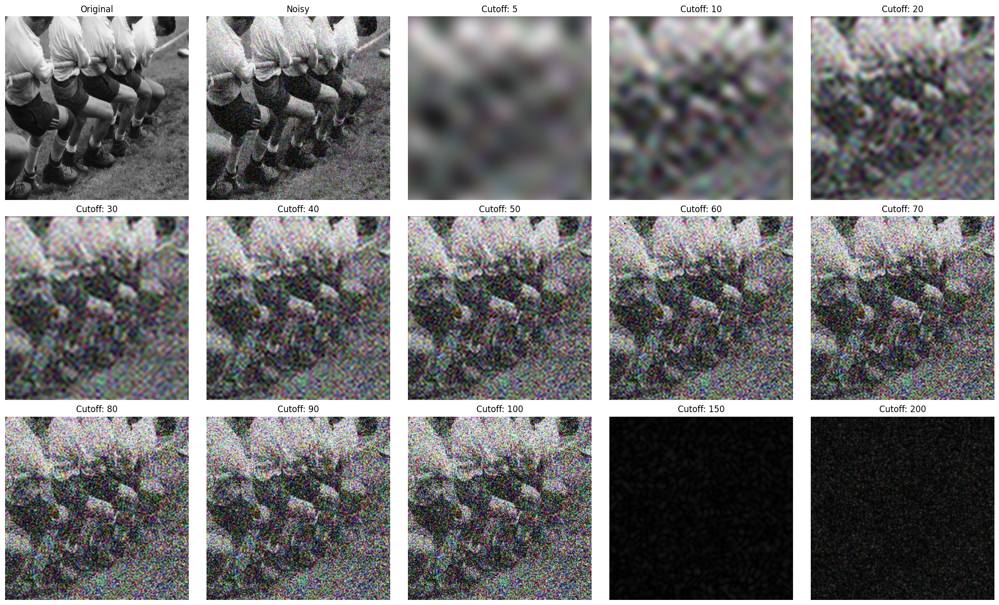

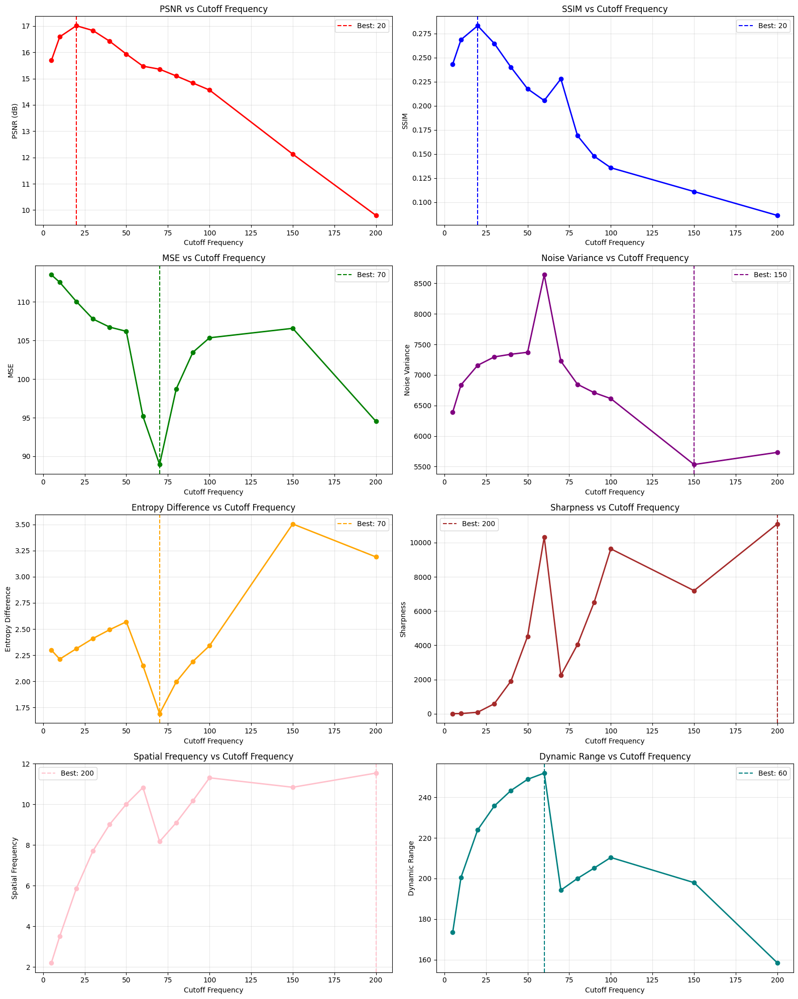

Most frequently best cutoff: 20 (appears 2 times)


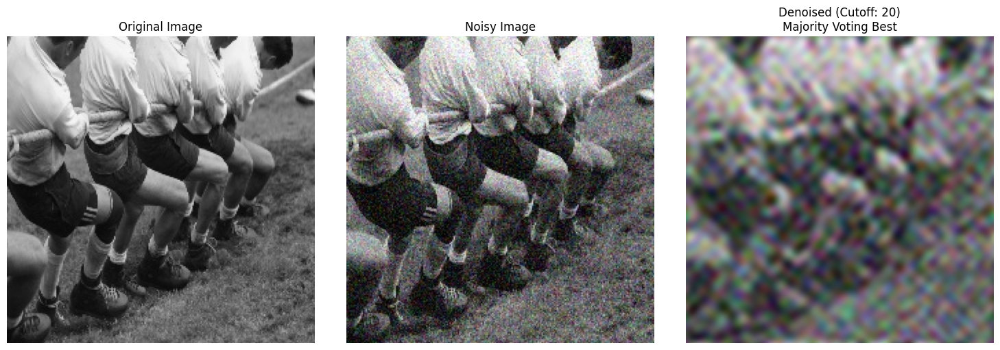

['Denoised_Cutoff_5_N(0,25).csv', 'Denoised_Cutoff_10_N(0,25).csv', 'Denoised_Cutoff_20_N(0,25).csv', 'Denoised_Cutoff_30_N(0,25).csv', 'Denoised_Cutoff_40_N(0,25).csv', 'Denoised_Cutoff_50_N(0,25).csv', 'Denoised_Cutoff_60_N(0,25).csv', 'Denoised_Cutoff_70_N(0,25).csv', 'Denoised_Cutoff_80_N(0,25).csv', 'Denoised_Cutoff_90_N(0,25).csv', 'Denoised_Cutoff_100_N(0,25).csv', 'Denoised_Cutoff_150_N(0,25).csv', 'Denoised_Cutoff_200_N(0,25).csv']
DEBUG: CSV cutoffs after extraction: [5, 10, 20, 30, 40, 50, 60, 70, 80, 90, 100, 150, 200]
DEBUG: CSV files order: ['Denoised_Cutoff_5_N(0,25).csv', 'Denoised_Cutoff_10_N(0,25).csv', 'Denoised_Cutoff_20_N(0,25).csv', 'Denoised_Cutoff_30_N(0,25).csv', 'Denoised_Cutoff_40_N(0,25).csv', 'Denoised_Cutoff_50_N(0,25).csv', 'Denoised_Cutoff_60_N(0,25).csv', 'Denoised_Cutoff_70_N(0,25).csv', 'Denoised_Cutoff_80_N(0,25).csv', 'Denoised_Cutoff_90_N(0,25).csv', 'Denoised_Cutoff_100_N(0,25).csv', 'Denoised_Cutoff_150_N(0,25).csv', 'Denoised_Cutoff_200_N(0,25).

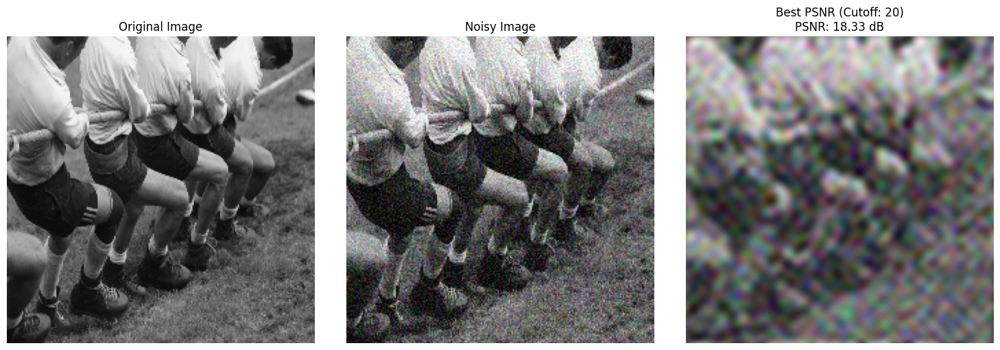

In [8]:
pic = random.randint(0, 79)
# Initialize all metric lists
mast_psnr = []
mast_ssim = []
mast_mse = []
mast_entropy_diff = []
mast_noise_variance = []
mast_sharpness = []
mast_spatial_freq = []
mast_dynamic_range = []
denoised_first_images = []  # Array to store denoised first images

def calculate_sharpness(image):
    # Using Laplacian variance as sharpness measure
    gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    return cv2.Laplacian(gray, cv2.CV_64F).var()

def calculate_spatial_frequency(image):
    gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    rf = np.diff(gray, axis=0)
    cf = np.diff(gray, axis=1)
    return np.sqrt(np.mean(rf**2) + np.mean(cf**2))

def calculate_dynamic_range(image):
    return np.max(image) - np.min(image)

for j in cutoffs: 
    counter = 0
    psnr_list = []
    ssim_list = []
    mse_list = []
    entropy_diff_list = []
    noise_variance_list = []
    sharpness_list = []
    spatial_freq_list = []
    dynamic_range_list = []
    rows_csv = []
    for i in tuple_list:
        original_img_path = original_folder_path + "/" + i[1]
        original_img = cv2.imread(original_img_path)
        original_img = cv2.cvtColor(original_img, cv2.COLOR_BGR2RGB)

        bw_img_path = BW_0_100 + "/" + i[3]
        bw_img = cv2.imread(bw_img_path)
        bw_img = cv2.cvtColor(bw_img, cv2.COLOR_BGR2RGB)

        # Denoising process
        denoised_channels = []
        for channel in range(3):
            channel_data = bw_img[:, :, channel]
            dft = np.fft.fft2(channel_data)
            dft_shift = np.fft.fftshift(dft)

            cutoff = j
            rows, cols = channel_data.shape
            crow, ccol = rows // 2, cols // 2

            mask = np.zeros((rows, cols), np.uint8)
            mask[crow-cutoff:crow+cutoff, ccol-cutoff:ccol+cutoff] = 1

            filtered_shift = dft_shift * mask
            f_ishift = np.fft.ifftshift(filtered_shift)
            denoised_channel = np.fft.ifft2(f_ishift)
            denoised_channel = np.abs(denoised_channel).astype(np.uint8)
            denoised_channels.append(denoised_channel)
        
        denoised = np.stack(denoised_channels, axis=2)
        
        if counter == pic:
            denoised_first_images.append(denoised)

        # Calculate all metrics
        # PSNR
        psnr_value = psnr(original_img, denoised)
        psnr_list.append(psnr_value)
        
        # SSIM
        ssim_value = ssim(original_img, denoised, channel_axis=2, data_range=255)
        ssim_list.append(ssim_value)
        
        # MSE
        mse_value = np.mean((original_img - denoised) ** 2)
        mse_list.append(mse_value)
        
        # Entropy Difference
        orig_entropy = shannon_entropy(original_img)
        denoised_entropy = shannon_entropy(denoised)
        entropy_diff_list.append(abs(orig_entropy - denoised_entropy))
        
        # Noise Variance (estimated as variance of difference)
        noise_variance_list.append(np.var(original_img - denoised))
        
        # Sharpness
        sharpness_list.append(calculate_sharpness(denoised))
        
        # Spatial Frequency
        spatial_freq_list.append(calculate_spatial_frequency(denoised))
        
        # Dynamic Range
        dynamic_range_list.append(calculate_dynamic_range(denoised))

        counter += 1
        rows_csv.append({"Name":i[2], "PSNR": psnr_value, "SSIM": ssim_value, "MSE": mse_value, "Entropy_Diff": abs(orig_entropy - denoised_entropy), 
                 "Noise_Variance": np.var(original_img - denoised), "Sharpness": calculate_sharpness(denoised), "Spatial_Freq": calculate_spatial_frequency(denoised), 
                 "Dynamic_Range": calculate_dynamic_range(denoised), "Majory": False})
    folder = "/Users/zevfine/Desktop/Noise_Reduction_CS506/Data_Results/Data/finished/m_0/100"

    filename = f"Denoised_Cutoff_{j}_N(0,25).csv"
    filepath = os.path.join(folder, filename)

    with open(filepath, mode="w") as csvfile:
        fieldnames = rows_csv[0].keys()
        writer = csv.DictWriter(csvfile, fieldnames=fieldnames)
        writer.writeheader()
        for row_csv in rows_csv:
            writer.writerow(row_csv)   
    # Store average metrics for this cutoff
    mast_psnr.append(np.mean(psnr_list))
    mast_ssim.append(np.mean(ssim_list))
    mast_mse.append(np.mean(mse_list))
    mast_entropy_diff.append(np.mean(entropy_diff_list))
    mast_noise_variance.append(np.mean(noise_variance_list))
    mast_sharpness.append(np.mean(sharpness_list))
    mast_spatial_freq.append(np.mean(spatial_freq_list))
    mast_dynamic_range.append(np.mean(dynamic_range_list))
graphs_folder = "/Users/zevfine/Desktop/Noise_Reduction_CS506/Data_Results/Data/finished/m_0/100/Graph_data"

# Get images for display
original_img_path = original_folder_path + "/" + tuple_list[pic][1]
original_img = cv2.imread(original_img_path)
original_img = cv2.cvtColor(original_img, cv2.COLOR_BGR2RGB)

noisy_img_path = BW_0_20 + "/" + tuple_list[pic][3]
noisy_img = cv2.imread(noisy_img_path)
noisy_img = cv2.cvtColor(noisy_img, cv2.COLOR_BGR2RGB)

all_images = [original_img, noisy_img] + denoised_first_images
all_titles = ["Original", "Noisy"] + [f"Cutoff: {cutoff}" for cutoff in cutoffs]

# Display images
# Display images
if all_images:
    plt.figure(figsize=(20, 12))
    for idx, img in enumerate(all_images):
        plt.subplot(3, 5, idx + 1)
        plt.title(all_titles[idx])
        plt.imshow(img)
        plt.axis('off')
    plt.tight_layout()

    # SAVE BEFORE SHOW
    outpath = os.path.join(graphs_folder, "comparison_grid.png")
    plt.savefig(outpath, dpi=300, bbox_inches='tight')

    # THEN SHOW
    plt.show()



# Find best cutoff for each metric
best_psnr_index = max(range(len(mast_psnr)), key=mast_psnr.__getitem__)
best_psnr_cutoff = cutoffs[best_psnr_index]

best_ssim_index = max(range(len(mast_ssim)), key=mast_ssim.__getitem__)
best_ssim_cutoff = cutoffs[best_ssim_index]

best_mse_index = min(range(len(mast_mse)), key=mast_mse.__getitem__)
best_mse_cutoff = cutoffs[best_mse_index]

best_noise_var_index = min(range(len(mast_noise_variance)), key=mast_noise_variance.__getitem__)
best_noise_var_cutoff = cutoffs[best_noise_var_index]

best_entropy_index = min(range(len(mast_entropy_diff)), key=mast_entropy_diff.__getitem__)
best_entropy_cutoff = cutoffs[best_entropy_index]

best_sharpness_index = max(range(len(mast_sharpness)), key=mast_sharpness.__getitem__)
best_sharpness_cutoff = cutoffs[best_sharpness_index]

best_spatial_freq_index = max(range(len(mast_spatial_freq)), key=mast_spatial_freq.__getitem__)
best_spatial_freq_cutoff = cutoffs[best_spatial_freq_index]

best_dynamic_range_index = max(range(len(mast_dynamic_range)), key=mast_dynamic_range.__getitem__)
best_dynamic_range_cutoff = cutoffs[best_dynamic_range_index]


# Check for duplicates
if len(cutoffs) != len(set(cutoffs)):
    print(f"WARNING: Duplicate cutoff values found!")
    from collections import Counter
    dup_counts = Counter(cutoffs)
    for cutoff, count in dup_counts.items():
        if count > 1:
            print(f"  Cutoff {cutoff} appears {count} times")

# Check if lengths match
if len(cutoffs) != len(mast_psnr):
    print(f"ERROR: Mismatch! cutoffs: {len(cutoffs)}, mast_psnr: {len(mast_psnr)}")

# Create individual plots for each metric
fig, axes = plt.subplots(4, 2, figsize=(16, 20))
axes = axes.ravel()

# PSNR
axes[0].axvline(x=best_psnr_cutoff, color='red', linestyle='--', label=f'Best: {best_psnr_cutoff}')
axes[0].plot(cutoffs, mast_psnr, color='red', linestyle='-', marker='o', linewidth=2)
axes[0].grid(True, alpha=0.3)
axes[0].set_xlabel('Cutoff Frequency')
axes[0].set_ylabel('PSNR (dB)')
axes[0].set_title('PSNR vs Cutoff Frequency')
axes[0].legend()
extent = axes[0].get_window_extent().transformed(fig.dpi_scale_trans.inverted())
extent = extent.expanded(1.1, 1.25)   # <— increase height to include title
fig.savefig(os.path.join(graphs_folder, "PSNR.png"), dpi=300, bbox_inches=extent)


# SSIM
axes[1].axvline(x=best_ssim_cutoff, color='blue', linestyle='--', label=f'Best: {best_ssim_cutoff}')
axes[1].plot(cutoffs, mast_ssim, color='blue', linestyle='-', marker='o', linewidth=2)
axes[1].grid(True, alpha=0.3)
axes[1].set_xlabel('Cutoff Frequency')
axes[1].set_ylabel('SSIM')
axes[1].set_title('SSIM vs Cutoff Frequency')
axes[1].legend()
extent = axes[1].get_window_extent().transformed(fig.dpi_scale_trans.inverted())
extent = extent.expanded(1.1, 1.25)   # <— increase height to include title
fig.savefig(os.path.join(graphs_folder, "SSIM.png"), dpi=300, bbox_inches=extent)
# MSE
axes[2].axvline(x=best_mse_cutoff, color='green', linestyle='--', label=f'Best: {best_mse_cutoff}')
axes[2].plot(cutoffs, mast_mse, color='green', linestyle='-', marker='o', linewidth=2)
axes[2].grid(True, alpha=0.3)
axes[2].set_xlabel('Cutoff Frequency')
axes[2].set_ylabel('MSE')
axes[2].set_title('MSE vs Cutoff Frequency')
axes[2].legend()
extent = axes[2].get_window_extent().transformed(fig.dpi_scale_trans.inverted())
extent = extent.expanded(1.1, 1.25)   # <— increase height to include title
fig.savefig(os.path.join(graphs_folder, "MSE.png"), dpi=300, bbox_inches=extent)
# Noise Variance
axes[3].axvline(x=best_noise_var_cutoff, color='purple', linestyle='--', label=f'Best: {best_noise_var_cutoff}')
axes[3].plot(cutoffs, mast_noise_variance, color='purple', linestyle='-', marker='o', linewidth=2)
axes[3].grid(True, alpha=0.3)
axes[3].set_xlabel('Cutoff Frequency')
axes[3].set_ylabel('Noise Variance')
axes[3].set_title('Noise Variance vs Cutoff Frequency')
axes[3].legend()
extent = axes[3].get_window_extent().transformed(fig.dpi_scale_trans.inverted())
extent = extent.expanded(1.1, 1.25)   # <— increase height to include title
fig.savefig(os.path.join(graphs_folder, "Noise Variance.png"), dpi=300, bbox_inches=extent)
# Entropy Difference
axes[4].axvline(x=best_entropy_cutoff, color='orange', linestyle='--', label=f'Best: {best_entropy_cutoff}')
axes[4].plot(cutoffs, mast_entropy_diff, color='orange', linestyle='-', marker='o', linewidth=2)
axes[4].grid(True, alpha=0.3)
axes[4].set_xlabel('Cutoff Frequency')
axes[4].set_ylabel('Entropy Difference')
axes[4].set_title('Entropy Difference vs Cutoff Frequency')
axes[4].legend()
extent = axes[4].get_window_extent().transformed(fig.dpi_scale_trans.inverted())
extent = extent.expanded(1.1, 1.25)   # <— increase height to include title
fig.savefig(os.path.join(graphs_folder, "Entropy Difference.png"), dpi=300, bbox_inches=extent)
# Sharpness
axes[5].axvline(x=best_sharpness_cutoff, color='brown', linestyle='--', label=f'Best: {best_sharpness_cutoff}')
axes[5].plot(cutoffs, mast_sharpness, color='brown', linestyle='-', marker='o', linewidth=2)
axes[5].grid(True, alpha=0.3)
axes[5].set_xlabel('Cutoff Frequency')
axes[5].set_ylabel('Sharpness')
axes[5].set_title('Sharpness vs Cutoff Frequency')
axes[5].legend()
extent = axes[5].get_window_extent().transformed(fig.dpi_scale_trans.inverted())
extent = extent.expanded(1.1, 1.25)   # <— increase height to include title
fig.savefig(os.path.join(graphs_folder, "Sharpness.png"), dpi=300, bbox_inches=extent)
# Spatial Frequency
axes[6].axvline(x=best_spatial_freq_cutoff, color='pink', linestyle='--', label=f'Best: {best_spatial_freq_cutoff}')
axes[6].plot(cutoffs, mast_spatial_freq, color='pink', linestyle='-', marker='o', linewidth=2)
axes[6].grid(True, alpha=0.3)
axes[6].set_xlabel('Cutoff Frequency')
axes[6].set_ylabel('Spatial Frequency')
axes[6].set_title('Spatial Frequency vs Cutoff Frequency')
axes[6].legend()
extent = axes[6].get_window_extent().transformed(fig.dpi_scale_trans.inverted())
extent = extent.expanded(1.1, 1.25)   # <— increase height to include title
fig.savefig(os.path.join(graphs_folder, "Spatial Frequency.png"), dpi=300, bbox_inches=extent)
# Dynamic Range
axes[7].axvline(x=best_dynamic_range_cutoff, color='teal', linestyle='--', label=f'Best: {best_dynamic_range_cutoff}')
axes[7].plot(cutoffs, mast_dynamic_range, color='teal', linestyle='-', marker='o', linewidth=2)
axes[7].grid(True, alpha=0.3)
axes[7].set_xlabel('Cutoff Frequency')
axes[7].set_ylabel('Dynamic Range')
axes[7].set_title('Dynamic Range vs Cutoff Frequency')
axes[7].legend()
extent = axes[7].get_window_extent().transformed(fig.dpi_scale_trans.inverted())
extent = extent.expanded(1.1, 1.25)   # <— increase height to include title
fig.savefig(os.path.join(graphs_folder, "Dynamic Range.png"), dpi=300, bbox_inches=extent)


plt.tight_layout()
outpath = os.path.join(graphs_folder, "all_metrics_individual.png")
plt.savefig(outpath, dpi=300, bbox_inches='tight')

plt.show()

# Find majority voting cutoff
best_cutoffs = [best_psnr_cutoff, best_ssim_cutoff, best_mse_cutoff,
                best_sharpness_cutoff, best_spatial_freq_cutoff,
                best_noise_var_cutoff, best_entropy_cutoff, best_dynamic_range_cutoff]

from collections import Counter
cutoff_counts = Counter(best_cutoffs)
most_common_cutoff = cutoff_counts.most_common(1)[0][0]
print(f"Most frequently best cutoff: {most_common_cutoff} (appears {cutoff_counts[most_common_cutoff]} times)")

# Get the denoised image using the majority cutoff
majority_denoised_index = cutoffs.index(most_common_cutoff)
majority_denoised_img = denoised_first_images[majority_denoised_index]

# Get the original and noisy images (image 75)
original_img_path = original_folder_path + "/" + tuple_list[pic][1]
original_img = cv2.imread(original_img_path)
original_img = cv2.cvtColor(original_img, cv2.COLOR_BGR2RGB)

noisy_img_path = BW_0_20 + "/" + tuple_list[pic][3]
noisy_img = cv2.imread(noisy_img_path)
noisy_img = cv2.cvtColor(noisy_img, cv2.COLOR_BGR2RGB)

# Create comparison plot
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Original
axes[0].imshow(original_img)
axes[0].set_title('Original Image')
axes[0].axis('off')

# Noisy
axes[1].imshow(noisy_img)
axes[1].set_title('Noisy Image')
axes[1].axis('off')

# Majority Denoised
axes[2].imshow(majority_denoised_img)
axes[2].set_title(f'Denoised (Cutoff: {most_common_cutoff})\nMajority Voting Best')
axes[2].axis('off')

plt.tight_layout()
outpath = os.path.join(graphs_folder, "Best_comparison_grid.png")
plt.savefig(outpath, dpi=300, bbox_inches='tight')
plt.show()




folder = "/Users/zevfine/Desktop/Noise_Reduction_CS506/Data_Results/Data/finished/m_0/100"

# Load all files
csv_files = sorted([f for f in os.listdir(folder) if f.endswith(".csv")], 
                   key=lambda x: int(x.split("_")[2].split(".")[0]))
print(csv_files)
# Extract cutoffs from filenames like: Denoised_Cutoff_70.csv
cutoffs = [int(f.split("_")[2].split(".")[0]) for f in csv_files]


# Extract cutoffs from filenames like: Denoised_Cutoff_70.csv
cutoffs = [int(f.split("_")[2].split(".")[0]) for f in csv_files]
print(f"DEBUG: CSV cutoffs after extraction: {cutoffs}")
print(f"DEBUG: CSV files order: {csv_files}")

# Load as list of DataFrames
dfs = [pd.read_csv(os.path.join(folder, f)) for f in csv_files]

# Assume all CSVs have same number of rows
num_rows = dfs[0].shape[0]

# For each row...
for row in range(num_rows):

    # Collect metric vectors for this row across all cutoffs
    mast_psnr =            [dfs[k].loc[row, "PSNR"]            for k in range(len(dfs))]
    mast_ssim =            [dfs[k].loc[row, "SSIM"]            for k in range(len(dfs))]
    mast_mse =             [dfs[k].loc[row, "MSE"]             for k in range(len(dfs))]
    mast_entropy_diff =    [dfs[k].loc[row, "Entropy_Diff"]    for k in range(len(dfs))]
    mast_noise_variance =  [dfs[k].loc[row, "Noise_Variance"]  for k in range(len(dfs))]
    mast_sharpness =       [dfs[k].loc[row, "Sharpness"]       for k in range(len(dfs))]
    mast_spatial_freq =    [dfs[k].loc[row, "Spatial_Freq"]    for k in range(len(dfs))]
    mast_dynamic_range =   [dfs[k].loc[row, "Dynamic_Range"]   for k in range(len(dfs))]

    # Best cutoffs for each metric
    best_psnr_cutoff          = cutoffs[max(range(len(mast_psnr)),         key=mast_psnr.__getitem__)]
    best_ssim_cutoff          = cutoffs[max(range(len(mast_ssim)),         key=mast_ssim.__getitem__)]
    best_sharpness_cutoff     = cutoffs[max(range(len(mast_sharpness)),    key=mast_sharpness.__getitem__)]
    best_spatial_freq_cutoff  = cutoffs[max(range(len(mast_spatial_freq)), key=mast_spatial_freq.__getitem__)]
    best_dynamic_cutoff       = cutoffs[max(range(len(mast_dynamic_range)),key=mast_dynamic_range.__getitem__)]

    best_mse_cutoff           = cutoffs[min(range(len(mast_mse)),          key=mast_mse.__getitem__)]
    best_entropy_cutoff       = cutoffs[min(range(len(mast_entropy_diff)), key=mast_entropy_diff.__getitem__)]
    best_noise_cutoff         = cutoffs[min(range(len(mast_noise_variance)),key=mast_noise_variance.__getitem__)]

    # Count votes
    votes = [
        best_psnr_cutoff, best_ssim_cutoff, best_sharpness_cutoff,
        best_spatial_freq_cutoff, best_dynamic_cutoff,
        best_mse_cutoff, best_entropy_cutoff, best_noise_cutoff
    ]

    # Find majority cutoff
    majority_cutoff = pd.Series(votes).mode().iloc[0]
    # Update Majory column for that cutoff’s CSV
    winning_index = cutoffs.index(majority_cutoff)
    dfs[winning_index].loc[row, "Majory"] = True

# Create comparison plot with Best PSNR instead of Majority
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Original
axes[0].imshow(original_img)
axes[0].set_title('Original Image')
axes[0].axis('off')

# Noisy
axes[1].imshow(noisy_img)
axes[1].set_title('Noisy Image')
axes[1].axis('off')

# Best PSNR
best_psnr_img = denoised_first_images[best_psnr_index]
axes[2].imshow(best_psnr_img)
axes[2].set_title(f'Best PSNR (Cutoff: {best_psnr_cutoff})\nPSNR: {mast_psnr[best_psnr_index]:.2f} dB')
axes[2].axis('off')

plt.tight_layout()
outpath = os.path.join(graphs_folder, "Best_PSNR_comparison.png")
plt.savefig(outpath, dpi=300, bbox_inches='tight')
plt.show()

# Save all CSV files back
for k, f in enumerate(csv_files):
    dfs[k].to_csv(os.path.join(folder, f), index=False)